In [1]:
import pandas as pd
import matplotlib.pyplot as plt

# Set global plot style and parameters
plt.style.use("ggplot")
plt.rcParams["figure.figsize"] = [20, 5]  # Set figure size
plt.rcParams["figure.dpi"] = 100  # Set figure resolution


In [5]:

# Load the data
df = pd.read_pickle("../../../data/interim/01_data_processes.pkl")  # Load processed dataset
df

,gyr_x,acc_x,acc_y,acc_z,gyr_y,gyr_z,label,category,participant,set,set'
epoch (ms),,,,,,,,,,,
2019-01-11 15:08:05.200,-1.8904,0.013500,0.977000,-0.071000,2.4392,0.9388,bench,heavy,B,64.0,64
2019-01-11 15:08:05.400,-1.6826,-0.001500,0.970500,-0.079500,-0.8904,2.1708,bench,heavy,B,64.0,64
2019-01-11 15:08:05.600,2.5608,0.001333,0.971667,-0.064333,-0.2560,-1.4146,bench,heavy,B,64.0,64
2019-01-11 15:08:05.800,8.0610,-0.024000,0.957000,-0.073500,-4.5244,-2.0730,bench,heavy,B,64.0,64
2019-01-11 15:08:06.000,2.4390,-0.028000,0.957667,-0.115000,-1.5486,-3.6098,bench,heavy,B,64.0,64
...,...,...,...,...,...,...,...,...,...,...,...
2019-01-20 17:33:27.000,1.4146,-0.048000,-1.041500,-0.076500,-5.6218,0.2926,row,medium,E,71.0,71
2019-01-20 17:33:27.200,-2.7684,-0.037000,-1.030333,-0.053333,-0.5854,2.2440,row,medium,E,71.0,71
2019-01-20 17:33:27.400,2.8416,-0.060000,-1.031000,-0.082000,-5.1342,-0.1220,row,medium,E,71.0,71


In [6]:

# Filter dataset where 'set' equals 1
set_df = df[df["set"] == 1]
set_df

,gyr_x,acc_x,acc_y,acc_z,gyr_y,gyr_z,label,category,participant,set,set'
epoch (ms),,,,,,,,,,,
2019-01-15 19:09:07.200,5.9390,0.169000,0.645000,0.662000,-4.6950,0.5610,squat,heavy,A,1.0,1
2019-01-15 19:09:07.400,-1.5976,0.163000,0.631000,0.658000,-2.9636,1.0732,squat,heavy,A,1.0,1
2019-01-15 19:09:07.600,-6.1706,0.153667,0.571333,0.607000,-3.9636,1.4998,squat,heavy,A,1.0,1
2019-01-15 19:09:07.800,-3.8414,0.180500,0.620500,0.675500,-3.1586,0.2440,squat,heavy,A,1.0,1
2019-01-15 19:09:08.000,-10.3538,0.185667,0.644667,0.727333,-3.2560,-4.0854,squat,heavy,A,1.0,1
...,...,...,...,...,...,...,...,...,...,...,...
2019-01-15 19:09:26.800,-7.5610,0.186667,0.505667,0.433667,7.1220,4.8780,squat,heavy,A,1.0,1
2019-01-15 19:09:27.000,-15.5608,0.234500,0.682000,0.572500,-2.8780,7.2562,squat,heavy,A,1.0,1
2019-01-15 19:09:27.200,-2.3658,0.265000,0.655667,0.700333,-2.8658,2.1222,squat,heavy,A,1.0,1


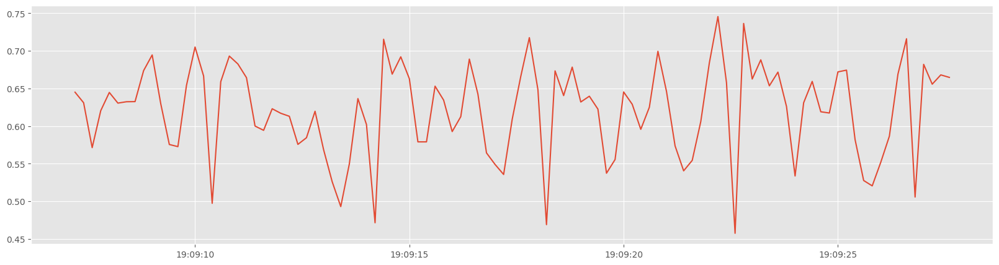

In [11]:

# Plot 'acc_y' for the filtered dataset
plt.plot(set_df["acc_y"])

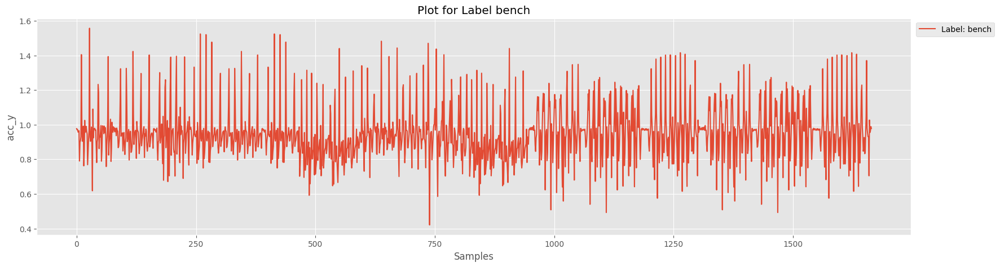

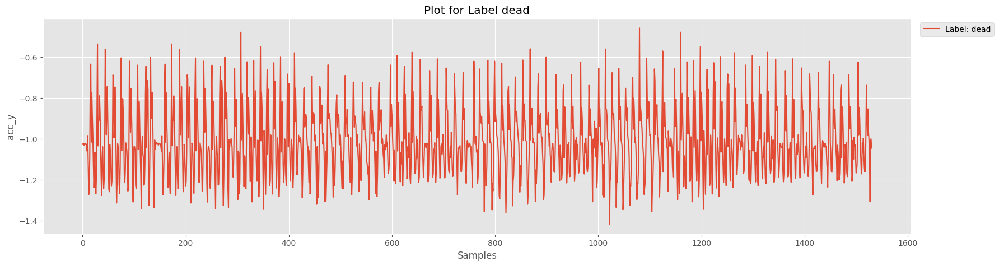

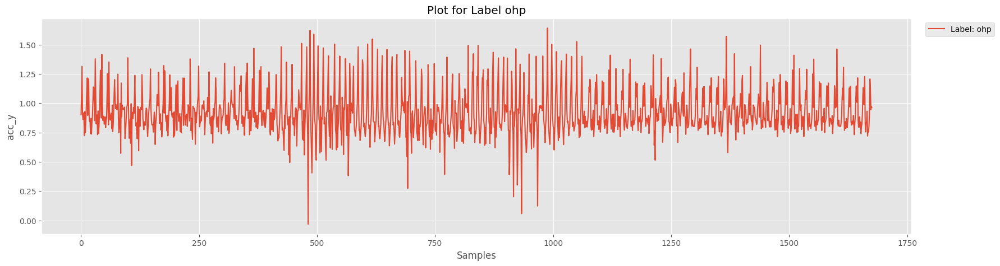

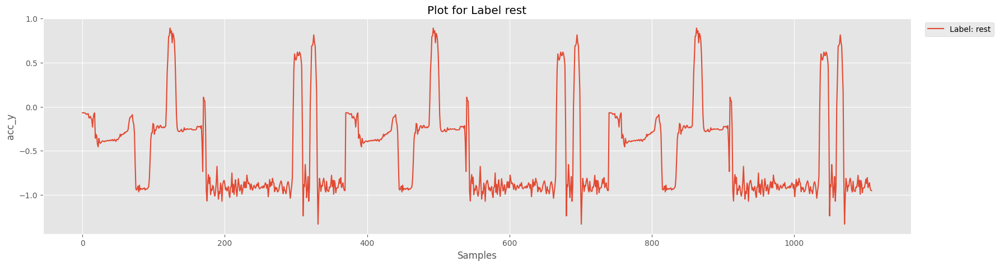

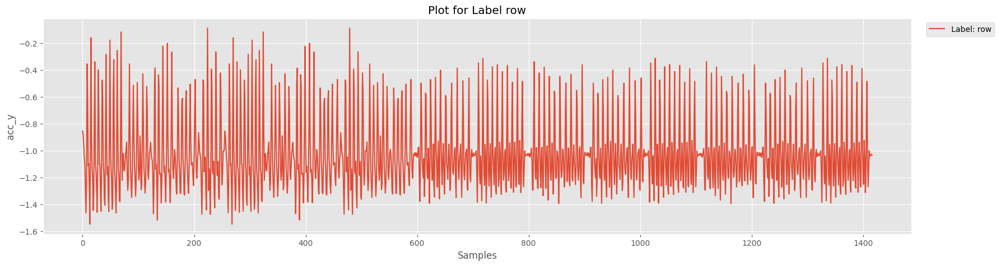

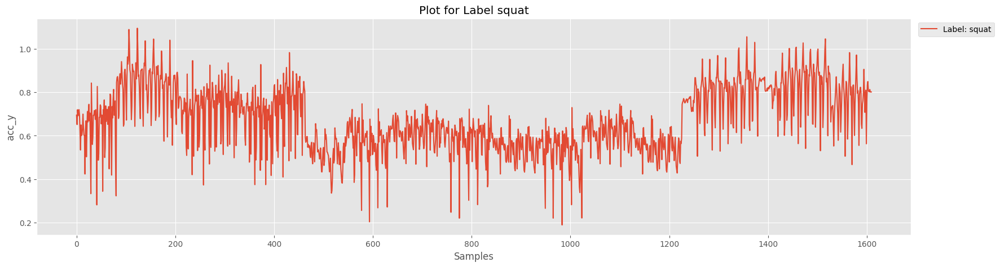

In [12]:

# Plot 'acc_y' for each label in the dataset
for label, subset in df.groupby("label"):
    plt.figure()
    plt.plot(subset["acc_y"].reset_index(drop=True), label=f"Label: {label}")
    plt.legend(loc="upper right", bbox_to_anchor=(1.1, 1))
    plt.title(f"Plot for Label {label}")
    plt.xlabel("Samples")
    plt.ylabel("acc_y")
    plt.show()

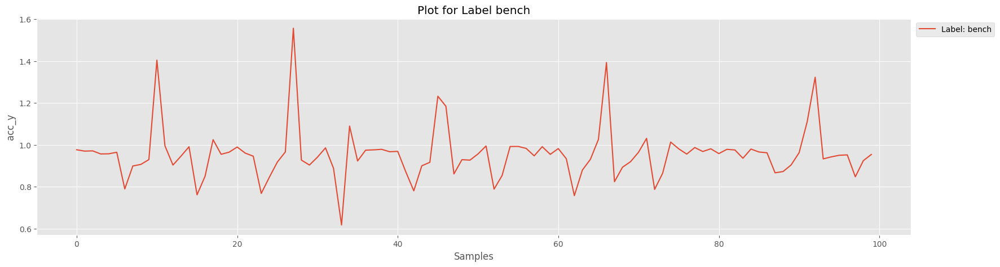

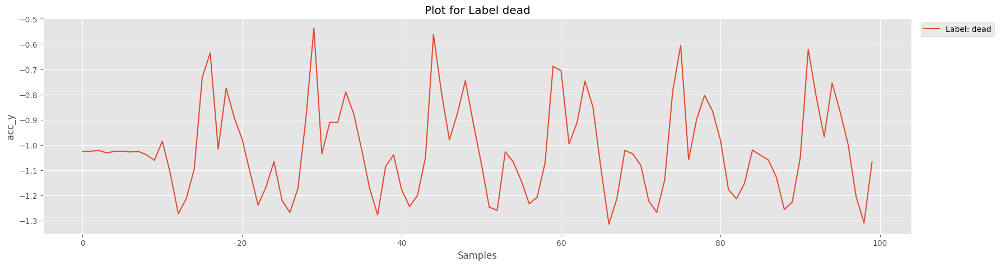

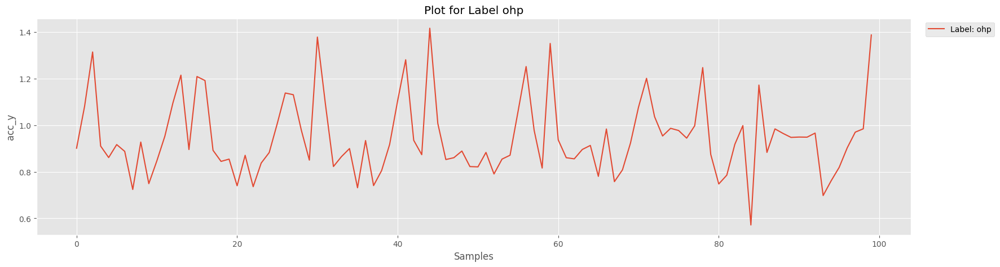

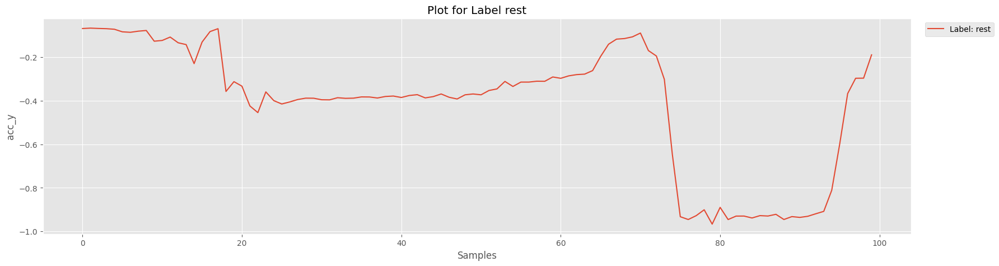

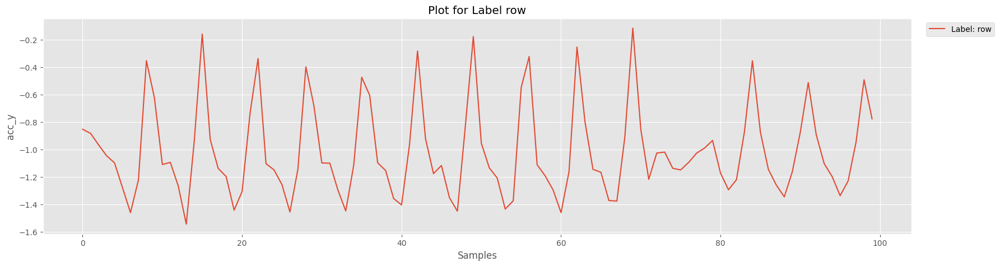

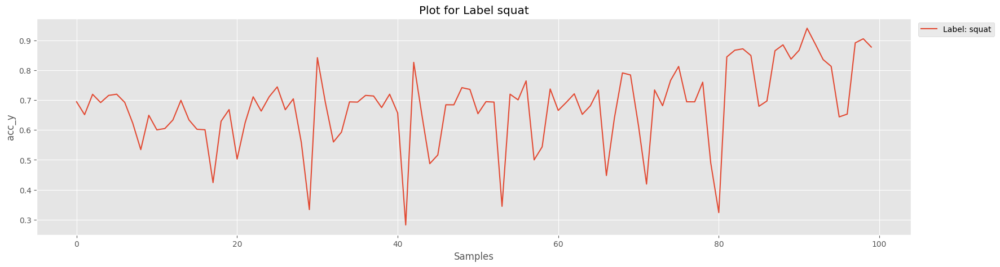

In [13]:

# Plot first 100 samples of 'acc_y' for each label
for label, subset in df.groupby("label"):
    plt.figure()
    plt.plot(subset["acc_y"][:100].reset_index(drop=True), label=f"Label: {label}")
    plt.legend(loc="upper right", bbox_to_anchor=(1.1, 1))
    plt.title(f"Plot for Label {label}")
    plt.xlabel("Samples")
    plt.ylabel("acc_y")
    plt.show()


In [14]:

# Filter dataset for label 'squat' and participant 'A'
category_df = df.query("label == 'squat'").query("participant == 'A'").reset_index()


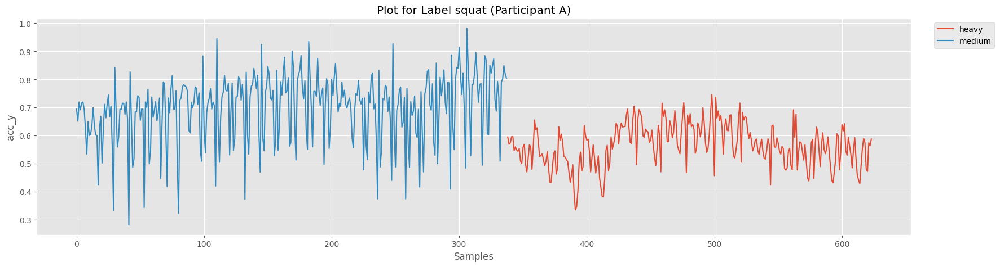

In [15]:

# Plot 'acc_y' grouped by 'category'
plt.figure()
category_df.groupby("category")["acc_y"].plot()
plt.legend(loc="upper right", bbox_to_anchor=(1.1, 1))
plt.title(f"Plot for Label squat (Participant A)")
plt.xlabel("Samples")
plt.ylabel("acc_y")
plt.show()

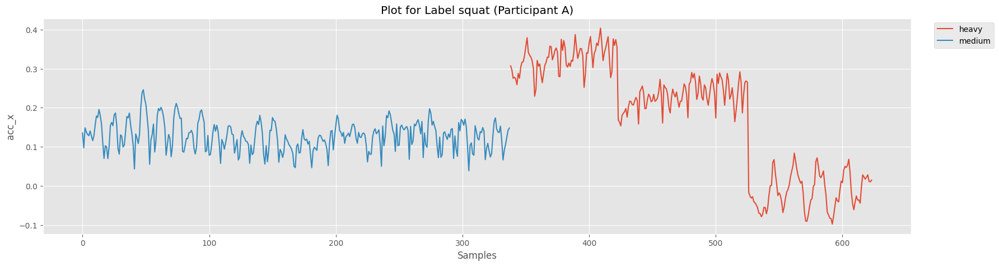

In [16]:

# Plot 'acc_x' grouped by 'category'
plt.figure()
category_df.groupby("category")["acc_x"].plot()
plt.legend(loc="upper right", bbox_to_anchor=(1.1, 1))
plt.title(f"Plot for Label squat (Participant A)")
plt.xlabel("Samples")
plt.ylabel("acc_x")
plt.show()


In [17]:

# Filter dataset for label 'bench', sorted by participant
Participant_df = df.query("label == 'bench'").sort_values("participant").reset_index()


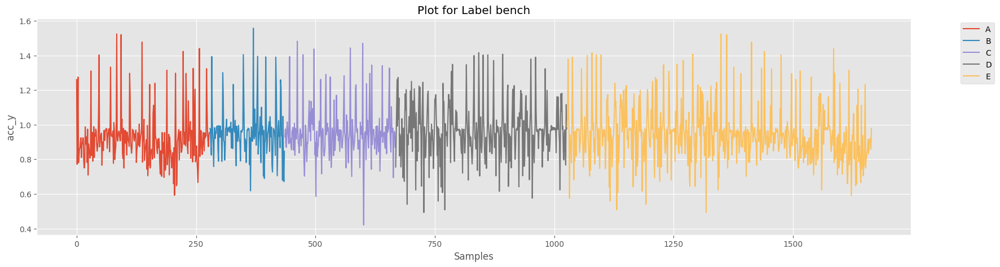

In [18]:

# Plot 'acc_y' grouped by participant
plt.figure()
Participant_df.groupby("participant")["acc_y"].plot()
plt.legend(loc="upper right", bbox_to_anchor=(1.1, 1))
plt.title(f"Plot for Label bench")
plt.xlabel("Samples")
plt.ylabel("acc_y")
plt.show()

In [19]:

# Filter dataset for a specific label and participant
label = "squat"
participant = "A"
all_axis_df = (
    df.query(f"label == '{label}'")
    .query(f"participant == '{participant}'")
    .reset_index()
)

<Figure size 2000x500 with 0 Axes>

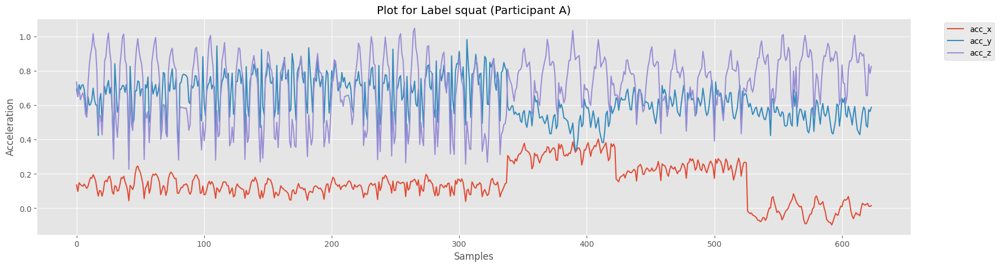

In [20]:

# Plot accelerometer data for all axes
plt.figure()
all_axis_df[["acc_x", "acc_y", "acc_z"]].plot()
plt.legend(loc="upper right", bbox_to_anchor=(1.1, 1))
plt.title(f"Plot for Label {label} (Participant {participant})")
plt.xlabel("Samples")
plt.ylabel("Acceleration")
plt.show()

In [21]:

# Get unique labels and participants
labels = df["label"].unique()
participants = df["participant"].unique()


<Figure size 2000x500 with 0 Axes>

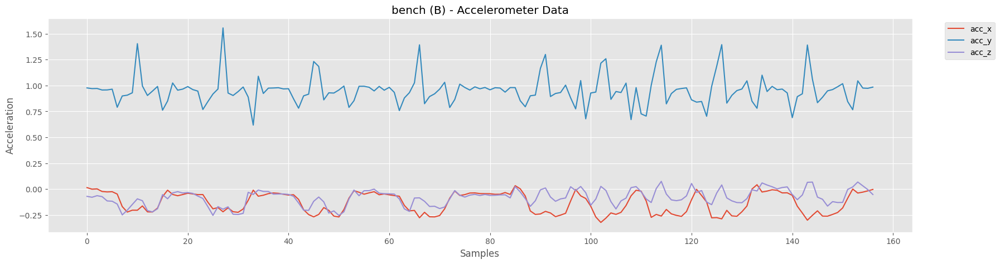

<Figure size 2000x500 with 0 Axes>

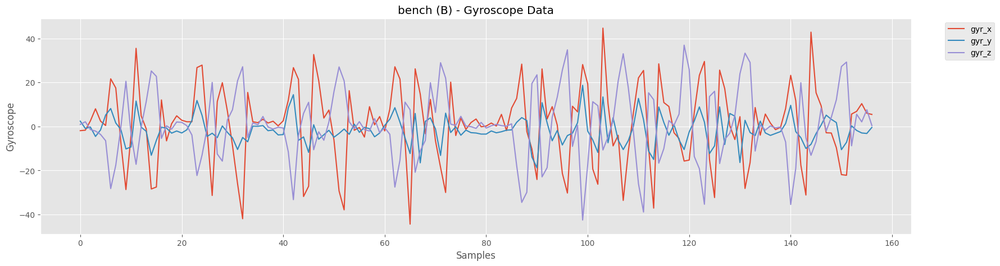

<Figure size 2000x500 with 0 Axes>

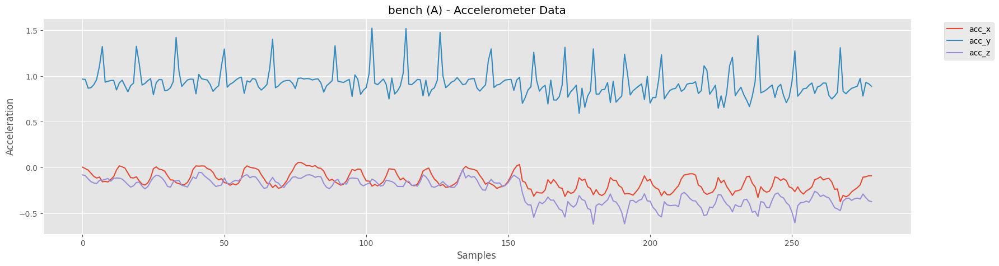

<Figure size 2000x500 with 0 Axes>

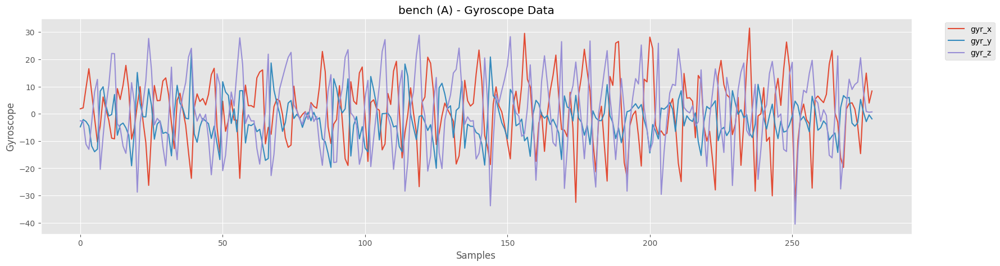

<Figure size 2000x500 with 0 Axes>

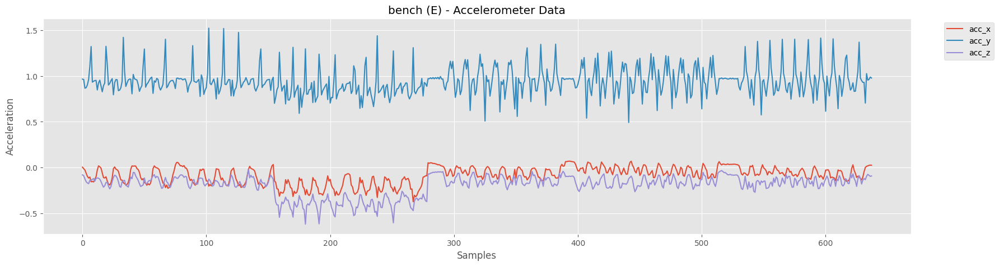

<Figure size 2000x500 with 0 Axes>

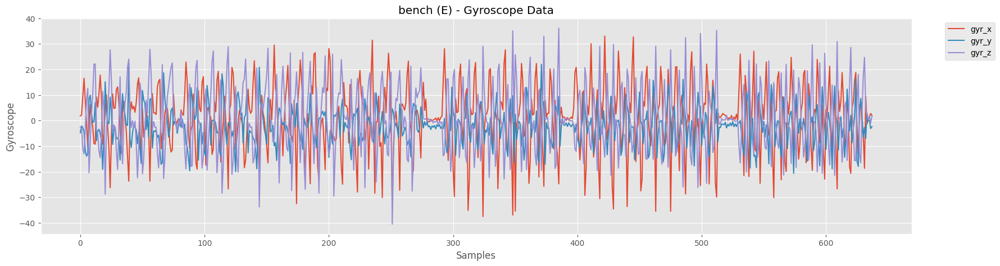

<Figure size 2000x500 with 0 Axes>

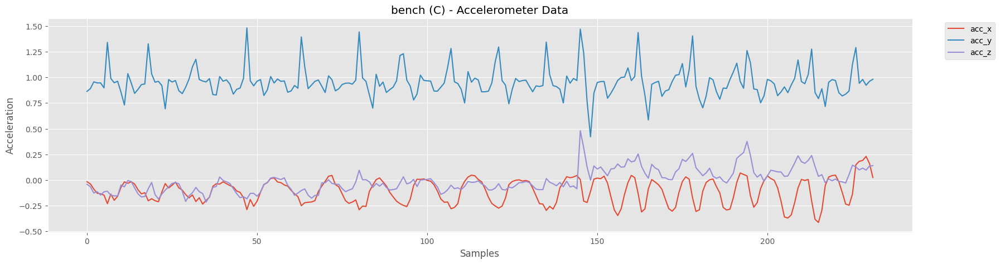

<Figure size 2000x500 with 0 Axes>

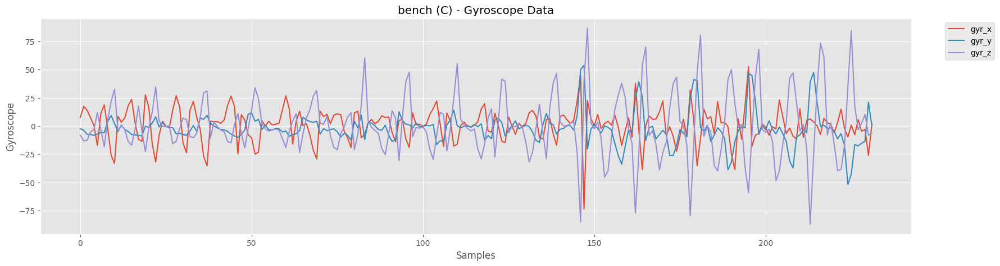

<Figure size 2000x500 with 0 Axes>

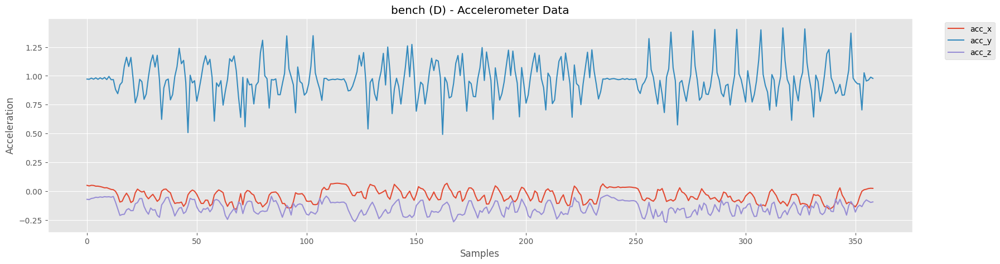

<Figure size 2000x500 with 0 Axes>

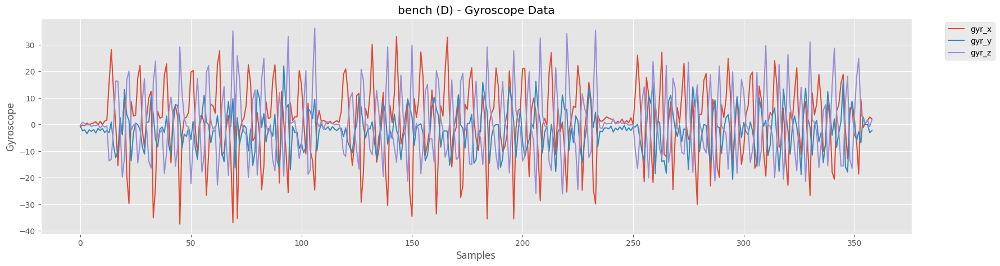

<Figure size 2000x500 with 0 Axes>

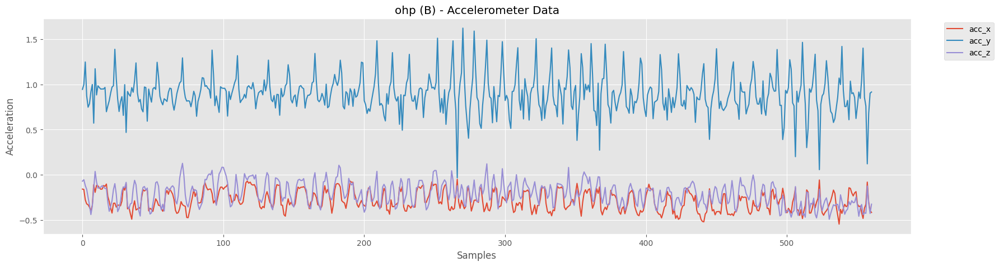

<Figure size 2000x500 with 0 Axes>

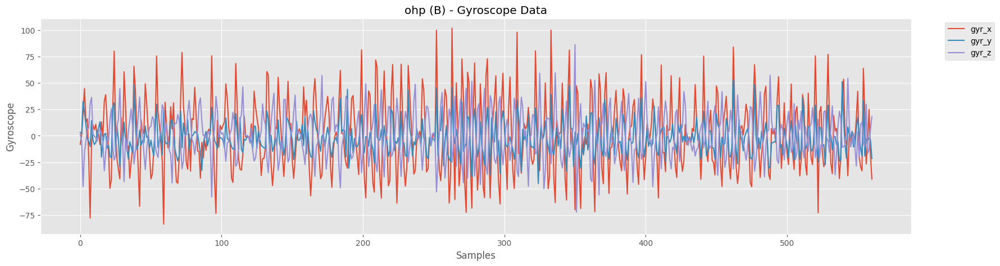

<Figure size 2000x500 with 0 Axes>

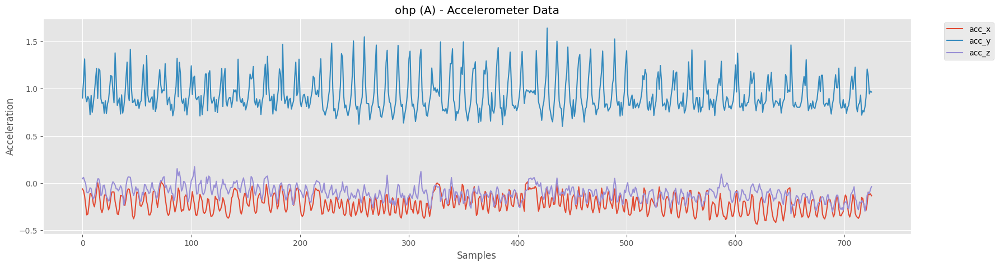

<Figure size 2000x500 with 0 Axes>

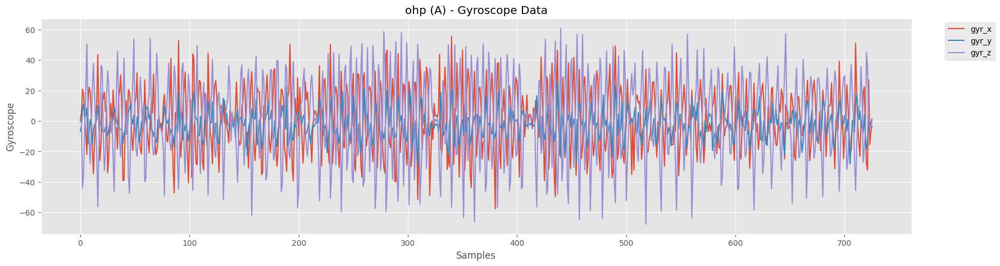

<Figure size 2000x500 with 0 Axes>

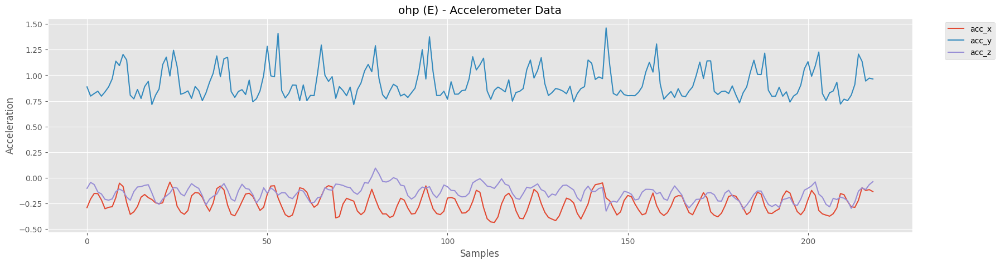

<Figure size 2000x500 with 0 Axes>

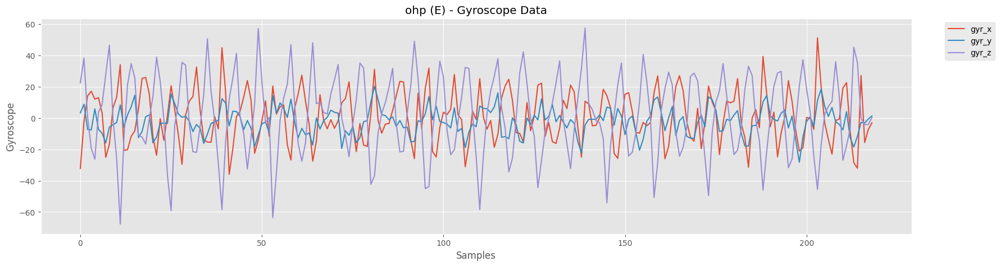

<Figure size 2000x500 with 0 Axes>

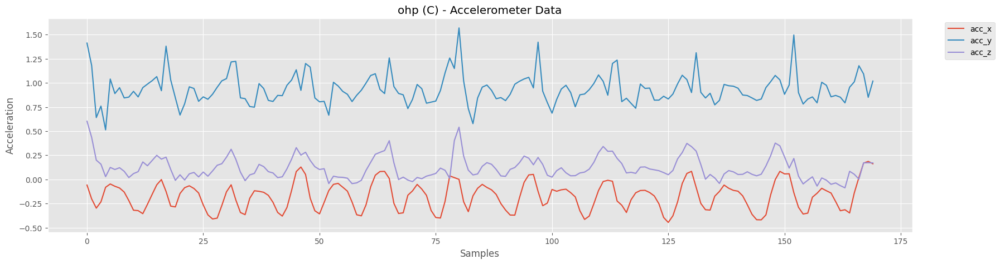

<Figure size 2000x500 with 0 Axes>

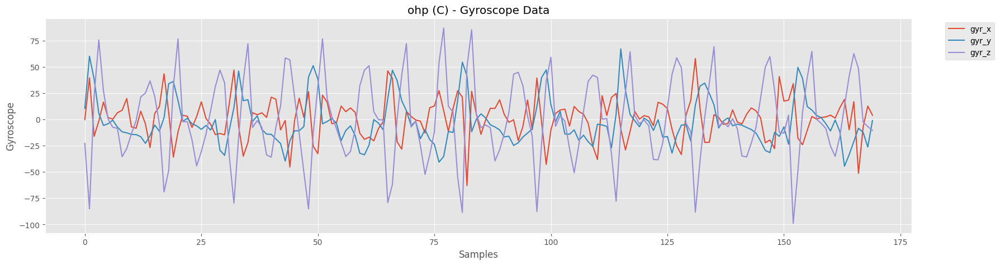

<Figure size 2000x500 with 0 Axes>

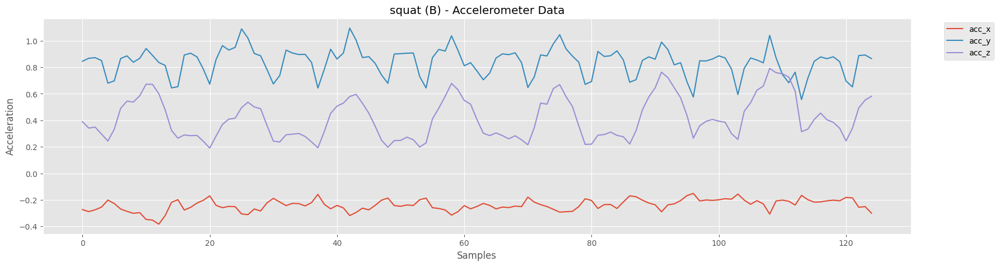

<Figure size 2000x500 with 0 Axes>

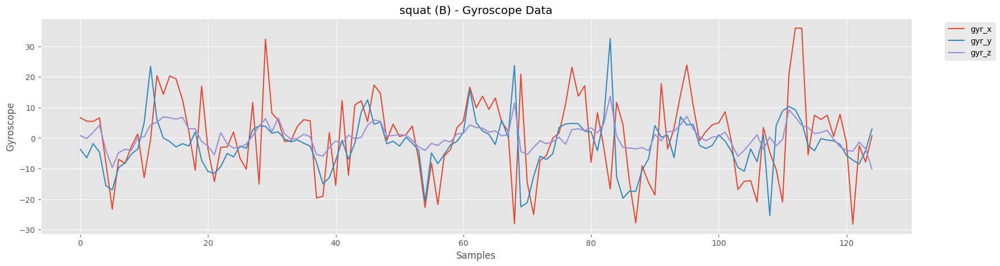

<Figure size 2000x500 with 0 Axes>

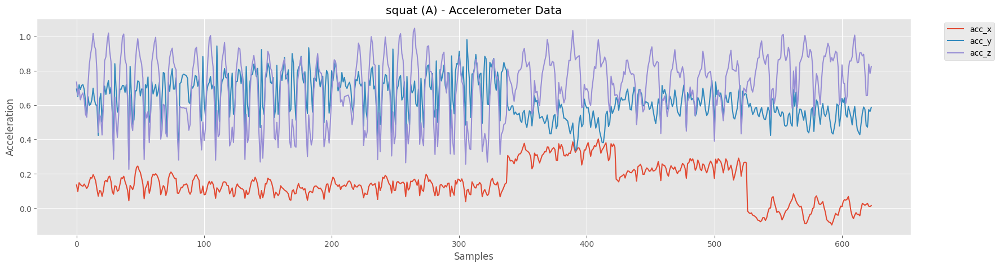

<Figure size 2000x500 with 0 Axes>

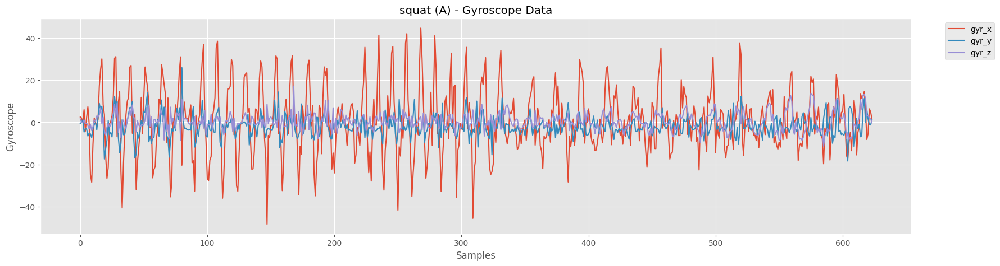

<Figure size 2000x500 with 0 Axes>

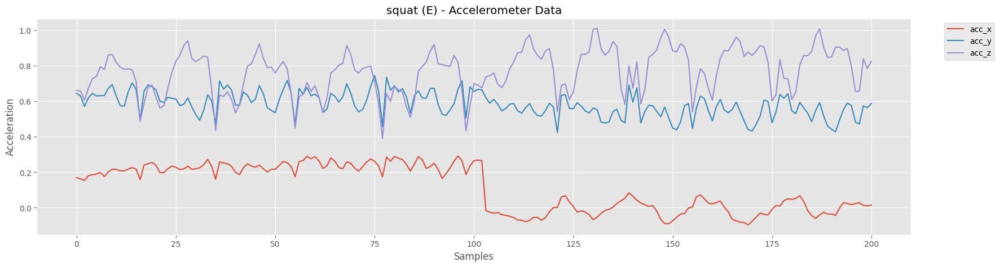

<Figure size 2000x500 with 0 Axes>

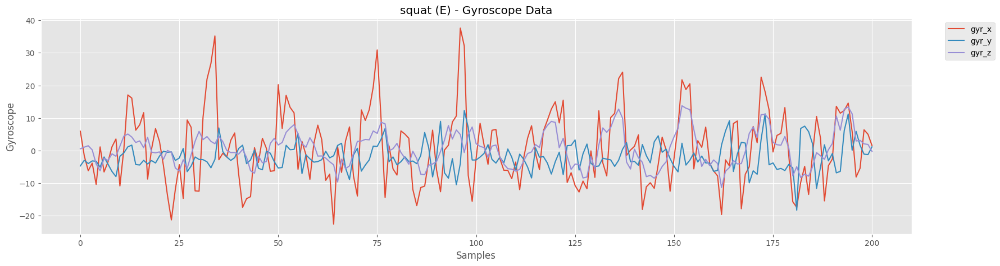

<Figure size 2000x500 with 0 Axes>

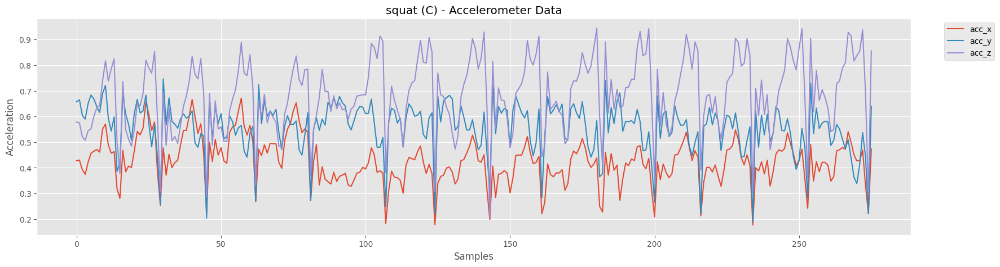

<Figure size 2000x500 with 0 Axes>

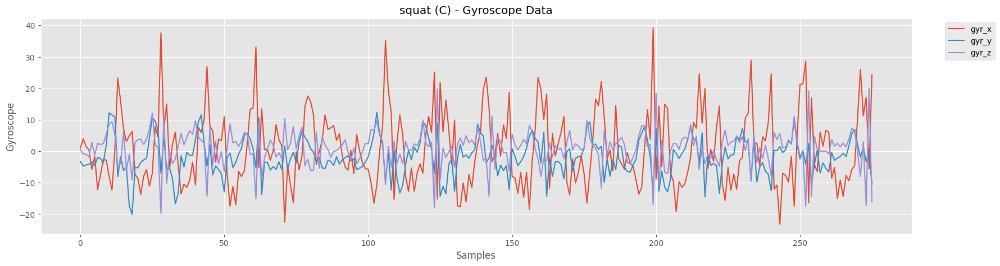

<Figure size 2000x500 with 0 Axes>

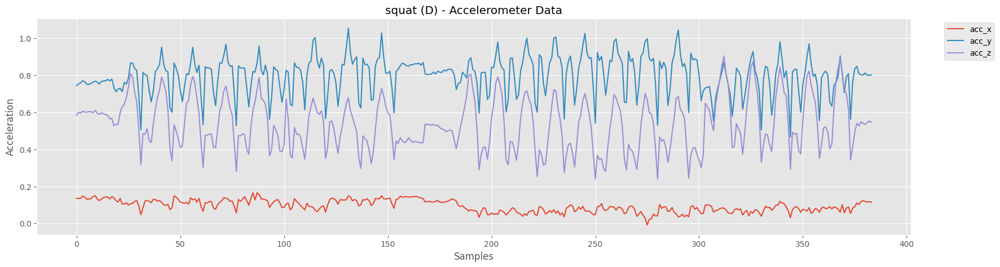

<Figure size 2000x500 with 0 Axes>

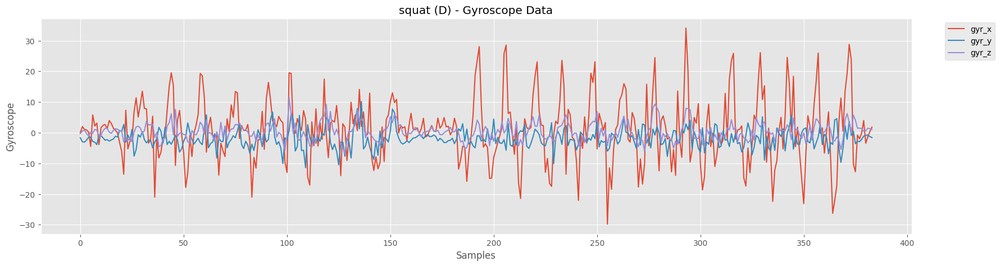

<Figure size 2000x500 with 0 Axes>

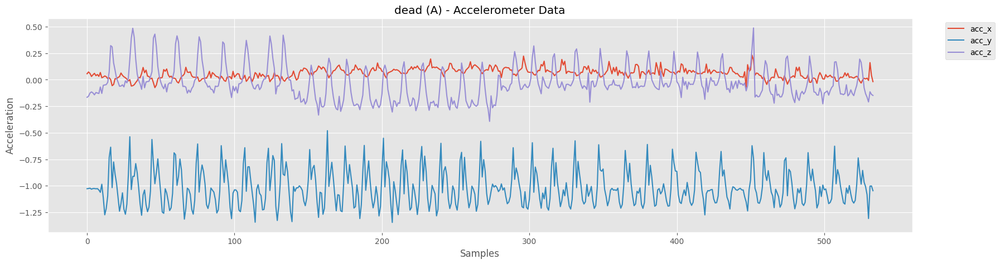

<Figure size 2000x500 with 0 Axes>

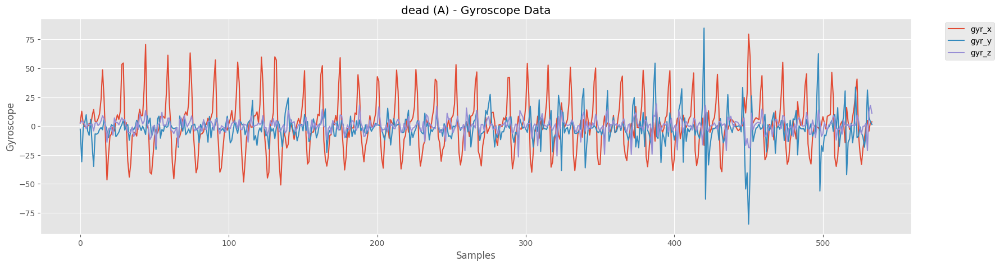

<Figure size 2000x500 with 0 Axes>

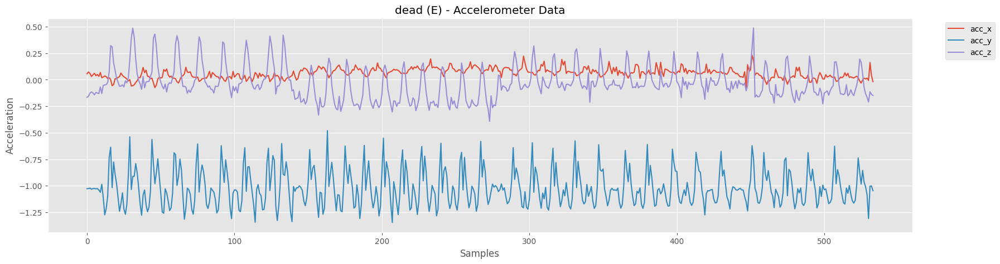

<Figure size 2000x500 with 0 Axes>

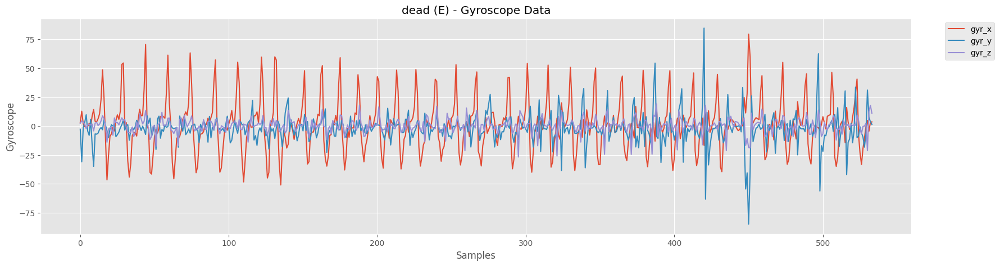

<Figure size 2000x500 with 0 Axes>

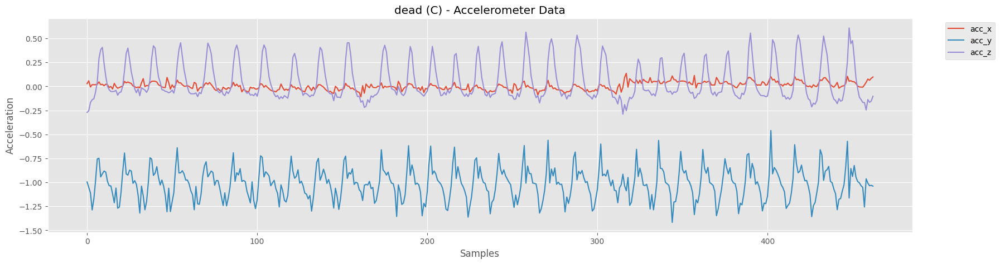

<Figure size 2000x500 with 0 Axes>

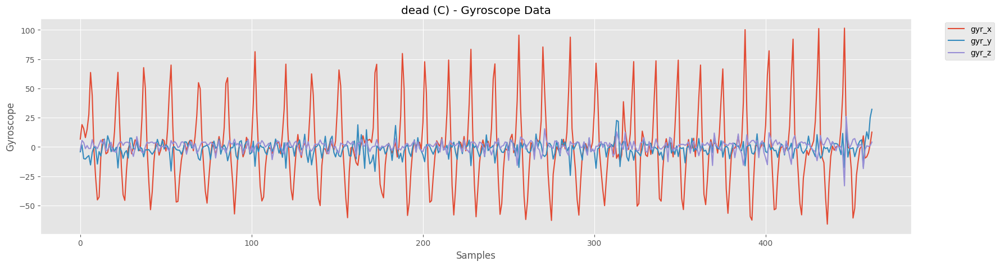

<Figure size 2000x500 with 0 Axes>

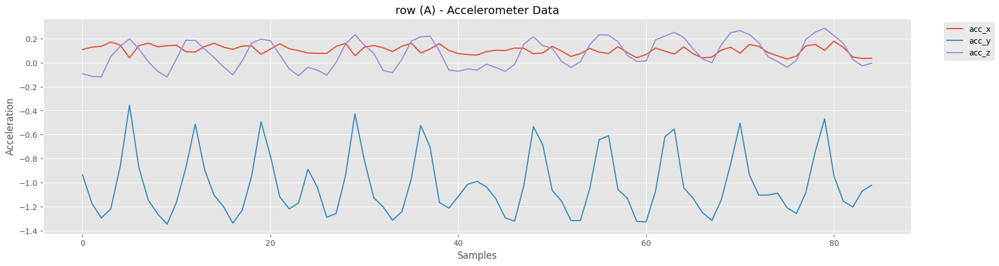

<Figure size 2000x500 with 0 Axes>

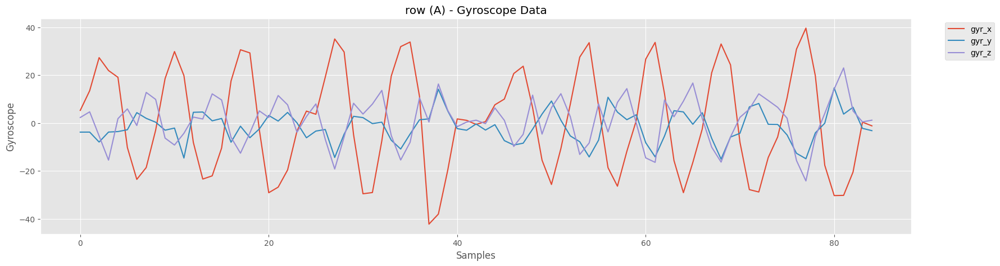

<Figure size 2000x500 with 0 Axes>

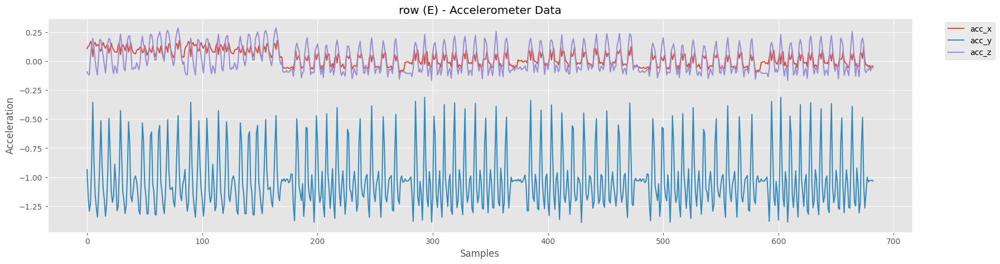

<Figure size 2000x500 with 0 Axes>

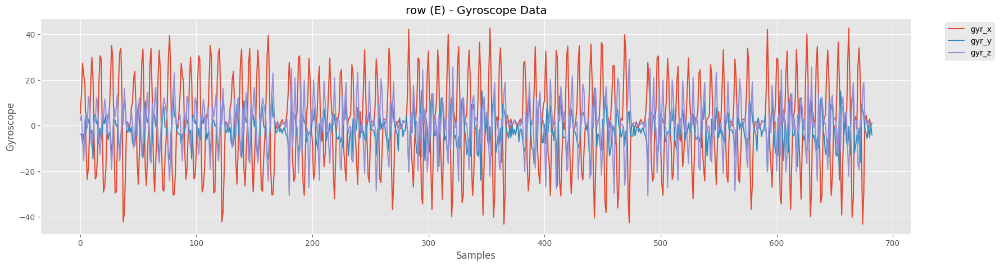

<Figure size 2000x500 with 0 Axes>

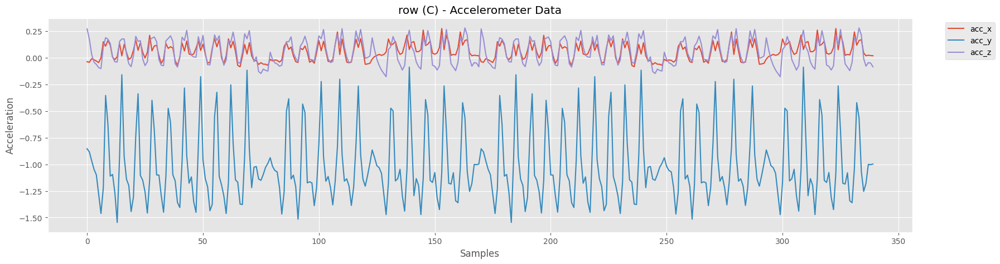

<Figure size 2000x500 with 0 Axes>

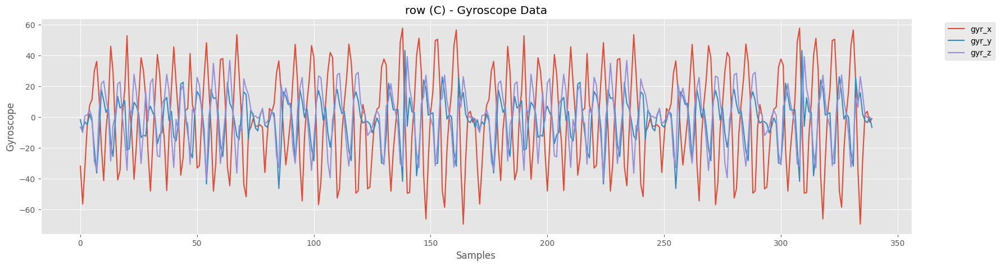

<Figure size 2000x500 with 0 Axes>

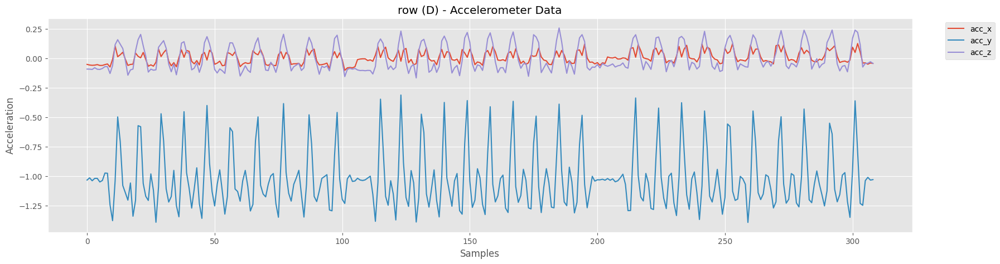

<Figure size 2000x500 with 0 Axes>

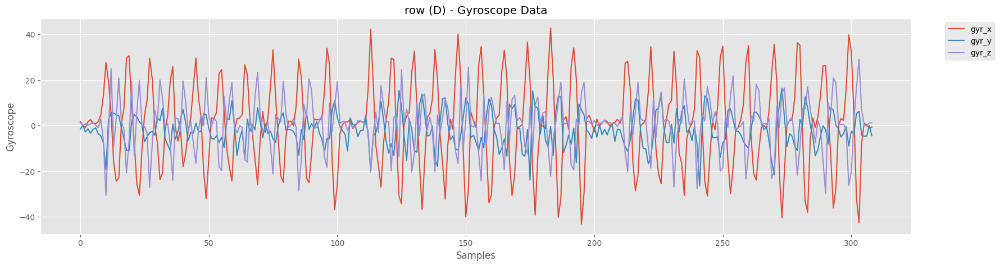

<Figure size 2000x500 with 0 Axes>

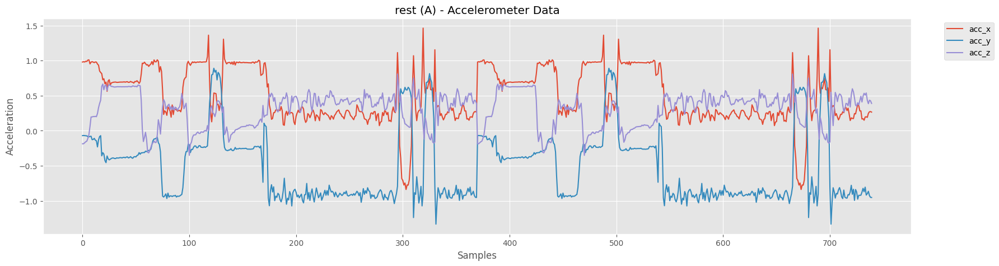

<Figure size 2000x500 with 0 Axes>

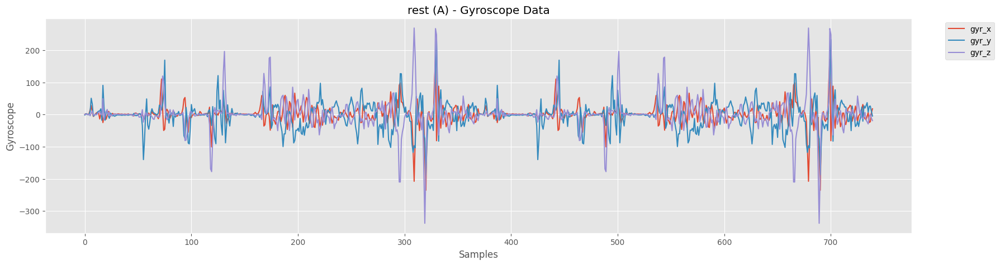

<Figure size 2000x500 with 0 Axes>

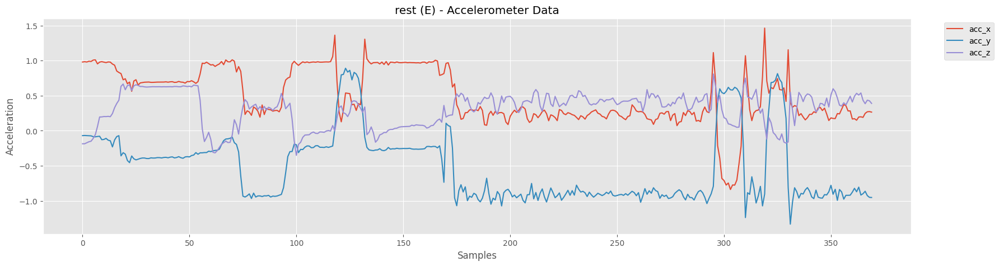

<Figure size 2000x500 with 0 Axes>

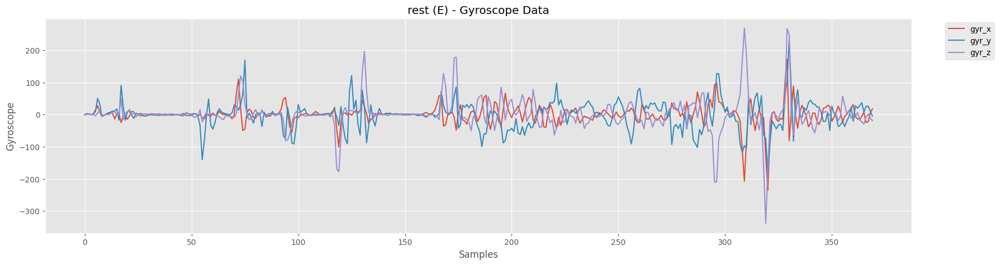

In [22]:

# Plot accelerometer and gyroscope data for each label and participant
for label in labels:
    for participant in participants:
        all_axis_df = (
            df.query(f"label == '{label}'")
            .query(f"participant == '{participant}'")
            .reset_index()
        )

        if len(all_axis_df) > 0:
            # Plot accelerometer data
            plt.figure()
            all_axis_df[["acc_x", "acc_y", "acc_z"]].plot()
            plt.legend(loc="upper right", bbox_to_anchor=(1.1, 1))
            plt.title(f"{label} ({participant}) - Accelerometer Data")
            plt.xlabel("Samples")
            plt.ylabel("Acceleration")
            plt.show()

            # Plot gyroscope data
            plt.figure()
            all_axis_df[["gyr_x", "gyr_y", "gyr_z"]].plot()
            plt.legend(loc="upper right", bbox_to_anchor=(1.1, 1))
            plt.title(f"{label} ({participant}) - Gyroscope Data")
            plt.xlabel("Samples")
            plt.ylabel("Gyroscope")
            plt.show()

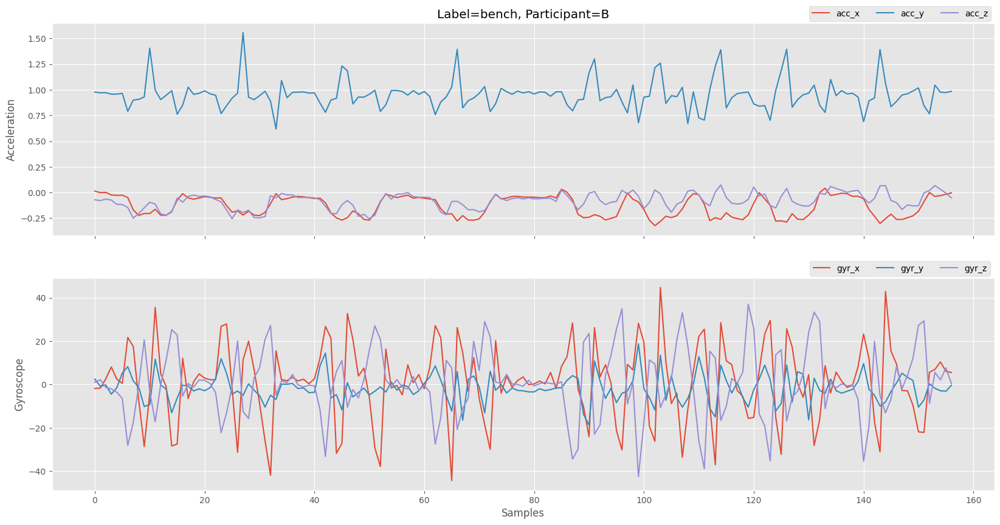

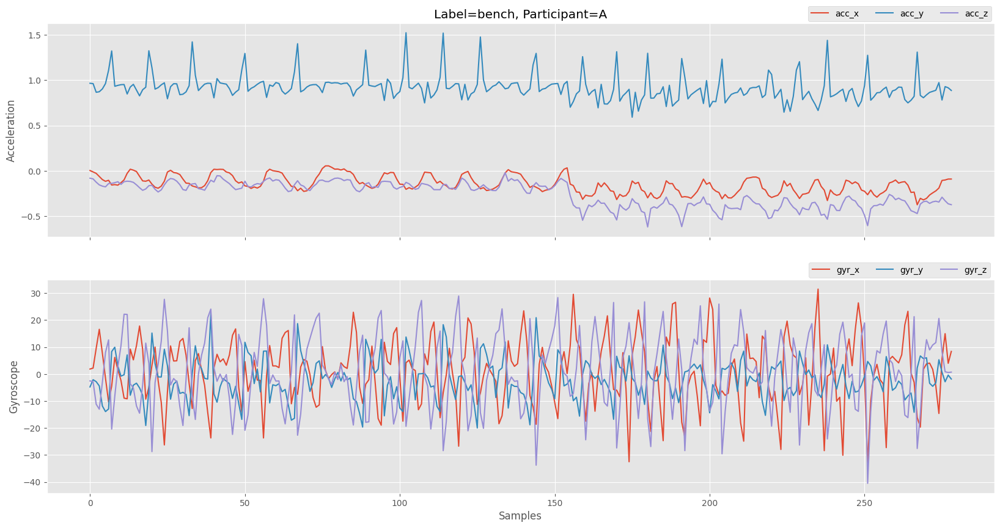

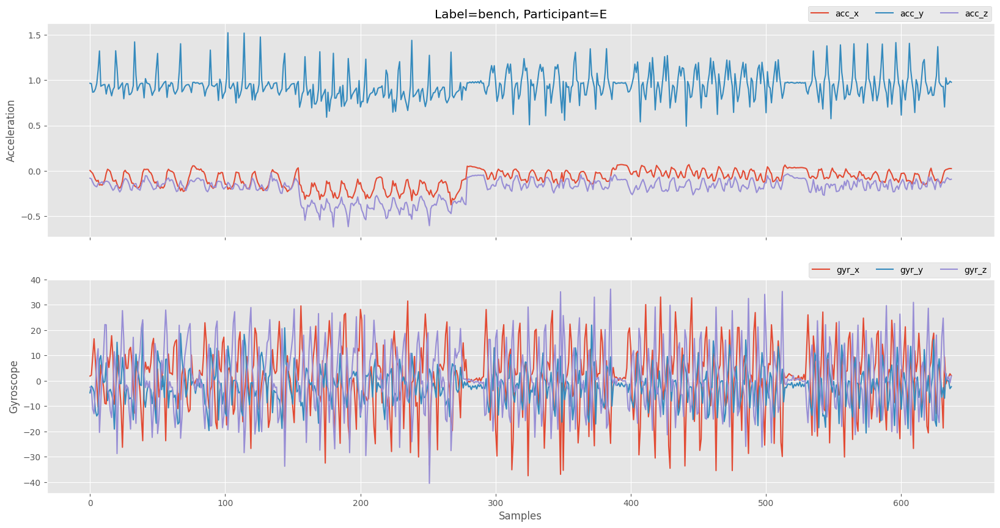

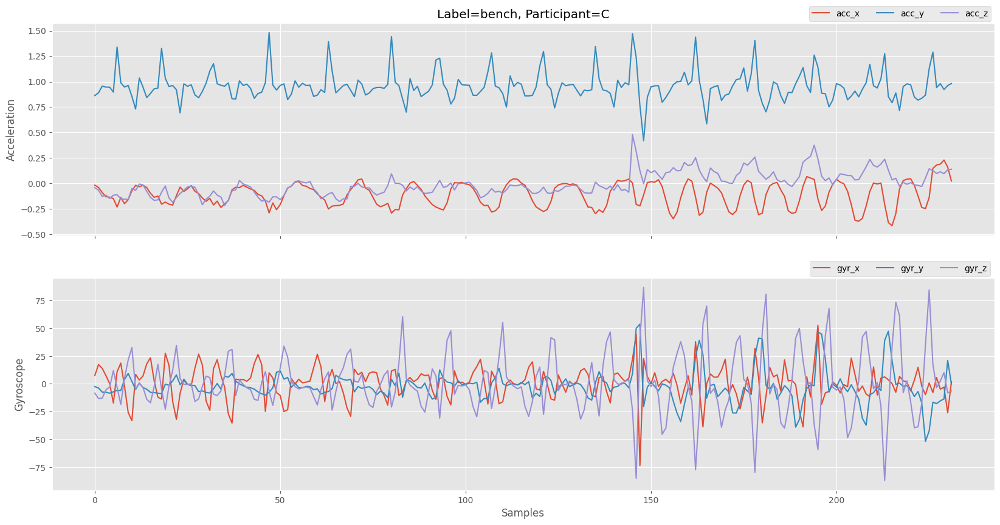

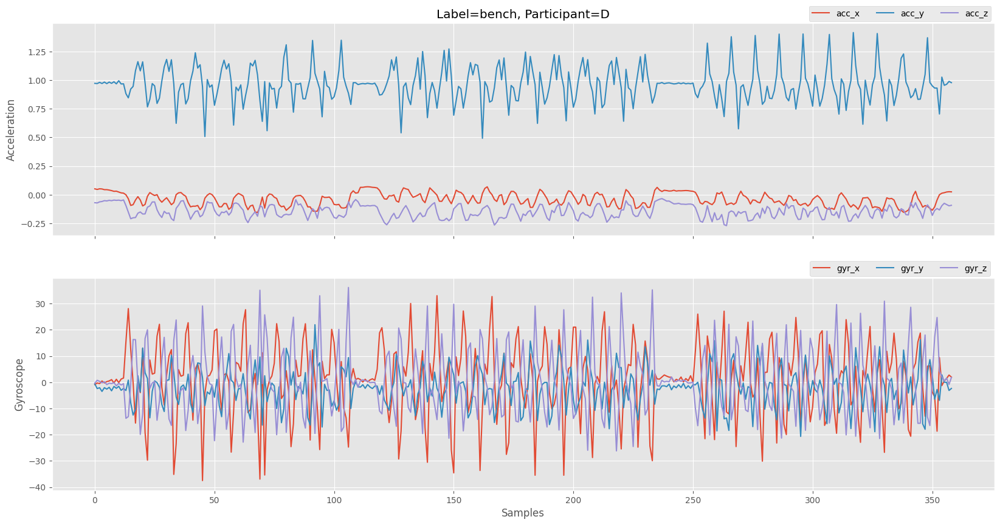

...

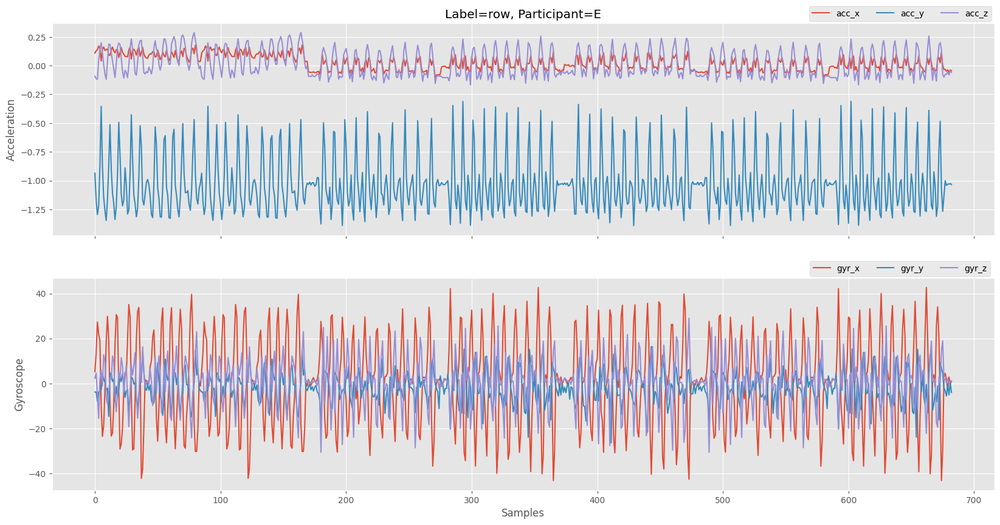

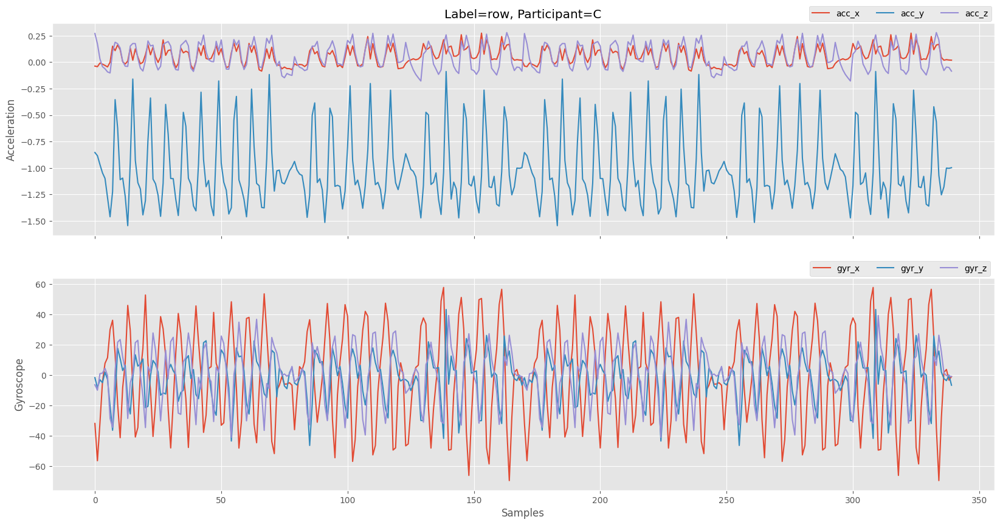

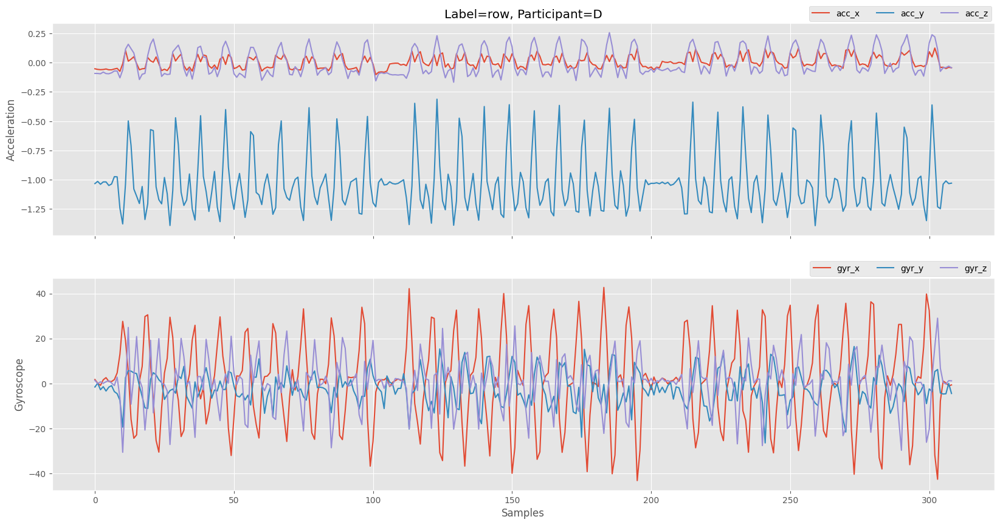

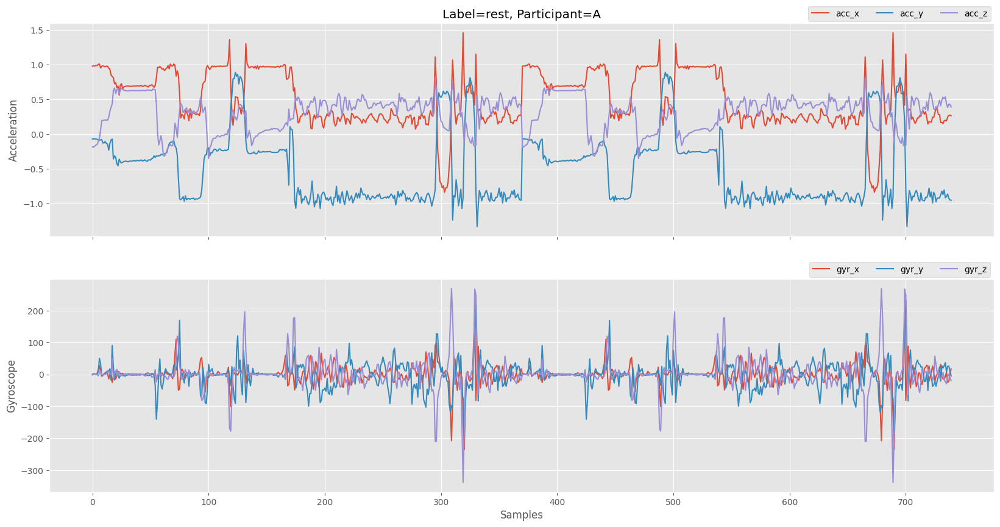

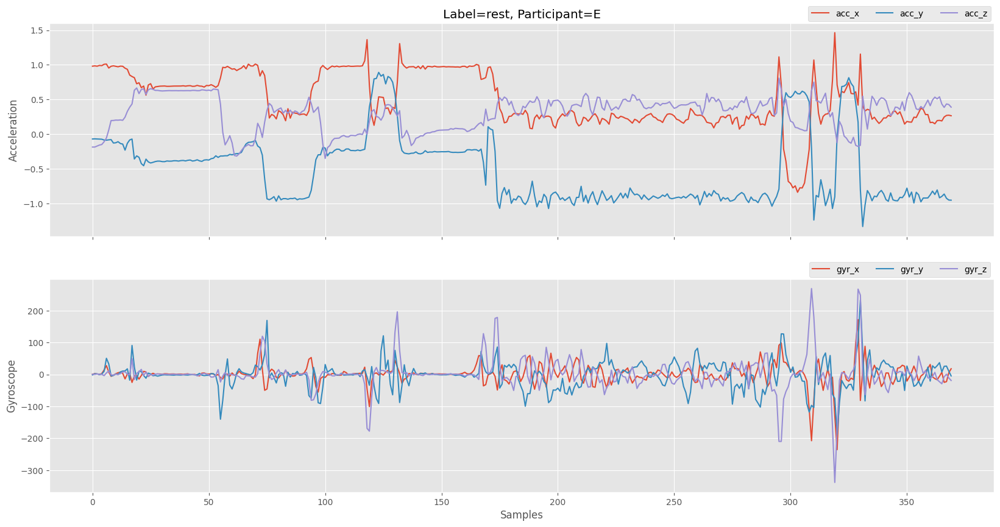

In [24]:

# Combined plots for accelerometer and gyroscope data
for label in labels:
    for participant in participants:
        all_axis_df = (
            df.query(f"label == '{label}'")
            .query(f"participant == '{participant}'")
            .reset_index()
        )

        if len(all_axis_df) > 0:
            fig, ax = plt.subplots(nrows=2, sharex=True, figsize=(20, 10))
            all_axis_df[["acc_x", "acc_y", "acc_z"]].plot(
                ax=ax[0]
            )  # Accelerometer data
            all_axis_df[["gyr_x", "gyr_y", "gyr_z"]].plot(ax=ax[1])  # Gyroscope data
            ax[0].legend(
                loc="upper center", bbox_to_anchor=(0.9, 1.1), ncol=3, fancybox=True
            )
            ax[1].legend(
                loc="upper center", bbox_to_anchor=(0.9, 1.1), ncol=3, fancybox=True
            )
            ax[1].set_xlabel("Samples")
            ax[0].set_ylabel("Acceleration")
            ax[1].set_ylabel("Gyroscope")
            ax[0].set_title(f"Label={label}, Participant={participant}")
            plt.savefig(f"../../../reports/figures/{label}_for_{participant}.png")
            plt.show()
